# RL and Advanced DL: Домашнее задание 3
Третье домашнее задание посвящено порождающим моделям, а точнее — порождающим состязательным сетям. Это самое маленькое и самое техническое задание в курсе, но что уж поделать. Как обычно, в качестве решения ожидается ссылка на jupyter-ноутбук на вашем github (или публичный, или с доступом для snikolenko); ссылку обязательно нужно прислать в виде сданного домашнего задания на портале Академии. Любые комментарии, новые идеи и рассуждения на тему, как всегда, категорически приветствуются.





## Часть первая: перенос стиля при помощи pix2pix
В этом задании мы будем реализовывать перенос стиля на спаренных данных (paired data). Из стандартных датасетов я выбрал самый маленький -- давайте реализуем перенос стиля из масок сегментации в “настоящие фотографии” для конкретного случая фасадов домов:
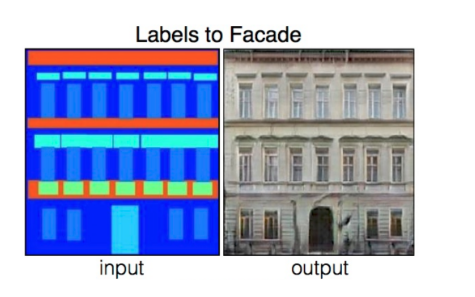
Датасет можно скачать здесь (и во многих других местах, должно быть ~29 мегабайт).
В первой части подразумевается реализация pix2pix архитектуры, т.е. генератора и дискриминатора, которые получают на вход условие в виде изображения исходного стиля (подробнее см. лекцию и собственно Isola et al., 2016):

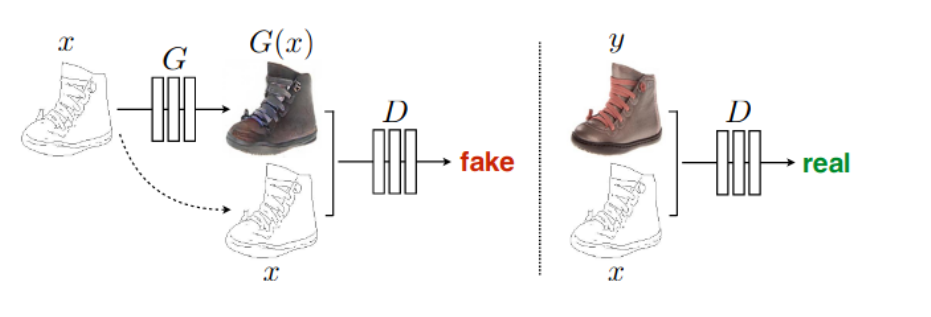


In [1]:
!wget http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/facades.tar.gz
!tar -xf facades.tar.gz

--2022-12-08 09:07:28--  http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/facades.tar.gz
Resolving efrosgans.eecs.berkeley.edu (efrosgans.eecs.berkeley.edu)... 128.32.244.190
Connecting to efrosgans.eecs.berkeley.edu (efrosgans.eecs.berkeley.edu)|128.32.244.190|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 30168306 (29M) [application/x-gzip]
Saving to: ‘facades.tar.gz’

facades.tar.gz      100%[===================>]  28.77M   724KB/s    in 43s     

2022-12-08 09:08:12 (689 KB/s) - ‘facades.tar.gz’ saved [30168306/30168306]



In [2]:
from glob import glob
import itertools
import random

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.autograd import Variable

from PIL import Image
from torchvision import transforms, utils
from IPython.display import display
from tqdm import tqdm

In [3]:
class FacsdesDataset(torch.utils.data.Dataset):
    
    def __init__(self, folder='facades/train'):
        self.folder = folder
        self.files = glob(self.folder + '/*.jpg');
        self.transforms = transforms.Compose([
            transforms.ToTensor(),
        ])
        
    def __getitem__(self, idx):
        imgs = Image.open(self.files[idx]).convert("RGB")
        img_from, img_to = imgs.crop((256, 0, 512, 256)), imgs.crop((0, 0, 256, 256))
        return self.transforms(img_from), self.transforms(img_to)    
    
        
    def __len__(self):
        return len(self.files)


train_dataset = FacsdesDataset(folder='facades/train')
train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=8, shuffle=True)

val_dataset = FacsdesDataset(folder='facades/test')
val_dataloader = torch.utils.data.DataLoader(val_dataset, batch_size=8, shuffle=False)

In [4]:
def conv_layer(in_challels, out_channels):
    return nn.Sequential(
        nn.Conv2d(in_challels, out_channels, kernel_size=3, padding=1),
        nn.InstanceNorm2d(out_channels, affine=True),
        nn.LeakyReLU(0.2, inplace=True),
        nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
        nn.InstanceNorm2d(out_channels, affine=True),
        nn.LeakyReLU(0.2, inplace=True),
    )

class UnetGenerator(nn.Module):
    def __init__(self):
        super().__init__()
        self.conv_down1 = conv_layer(3, 64)
        self.conv_down2 = conv_layer(64, 128)
        self.conv_down3 = conv_layer(128, 256)
        self.conv_down4 = conv_layer(256, 512)
        self.conv_down5 = conv_layer(512, 1024)
        
        self.conv_up1 = conv_layer(512 + 1024, 512)
        self.conv_up2 = conv_layer(256 + 512, 256)
        self.conv_up3 = conv_layer(128 + 256, 128)
        self.conv_up4 = conv_layer(64 + 128, 64)
        self.conv_up5 = nn.Conv2d(64, 3, kernel_size=1)
        
        self.down = nn.MaxPool2d(kernel_size=2)
        self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        
        
    def forward(self, x):
        out1 = self.conv_down1(x)
        out1 = F.dropout(out1)
        x = self.down(out1)
        
        out2 = self.conv_down2(x)
        out2 = F.dropout(out2)
        x = self.down(out2)
        
        out3 = self.conv_down3(x)
        out3 = F.dropout(out3)
        x = self.down(out3)

        out4 = self.conv_down4(x)
        out4 = F.dropout(out4)
        x = self.down(out4)
        
        x = self.conv_down5(x)
        
        x = self.up(x)    
        x = torch.cat([x, out4], dim=1)
        x = self.conv_up1(x)
        
        x = self.up(x)        
        x = torch.cat([x, out3], dim=1)
        x = self.conv_up2(x)
        
        x = self.up(x)        
        x = torch.cat([x, out2], dim=1)
        x = self.conv_up3(x)

        x = self.up(x)        
        x = torch.cat([x, out1], dim=1)
        x = self.conv_up4(x)
        
        x = self.conv_up5(x)
        x = torch.sigmoid(x)
        return x
   
        

class Discriminator(nn.Module):
    def __init__(self, is_single=False):
        super().__init__()
        self.is_single = is_single
        self.conv_down1 = conv_layer(3 if is_single else 6, 64)
        self.conv_down2 = conv_layer(64, 128)
        self.conv_down3 = conv_layer(128, 256)
        self.conv_down4 = conv_layer(256, 512)
        self.down = nn.MaxPool2d(kernel_size=2)
        
        self.pooling = nn.AdaptiveAvgPool2d((1, 1))
        self.fc = nn.Linear(512, 2)
        
    def forward(self, condition, x=None):
        if self.is_single:
            x = condition
        else:
            x = torch.cat([condition, x], dim=1)
        
        x = self.conv_down1(x)
        x = self.down(x)
        x = F.dropout(x)
        
        x = self.conv_down2(x)
        x = self.down(x)
        x = F.dropout(x)
        
        x = self.conv_down3(x)
        x = self.down(x)
        
        x = self.conv_down4(x)
        x = self.down(x) 
        
        x = self.pooling(x)
        x = x.squeeze(-1).squeeze(-1) 
        x = self.fc(x)

        return x
        
        

In [5]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
device

device(type='cuda')

In [6]:
G = UnetGenerator().to(device)
D = Discriminator().to(device)

In [7]:
G_optim = torch.optim.Adam(G.parameters(), lr=0.0002, betas=(0.5, 0.999))
G_scheduler = torch.optim.lr_scheduler.StepLR(G_optim, 200)
D_optim = torch.optim.Adam(D.parameters(), lr=0.0002, betas=(0.5, 0.999))
D_scheduler = torch.optim.lr_scheduler.StepLR(D_optim, 200)

epoch: 1


epoch: 2


epoch: 3


epoch: 4


epoch: 5


epoch: 6


epoch: 7


epoch: 8


epoch: 9


epoch: 10


epoch: 11


epoch: 12


epoch: 13


epoch: 14


epoch: 15


epoch: 16


epoch: 17


epoch: 18


epoch: 19


epoch: 20
Epoch: 20


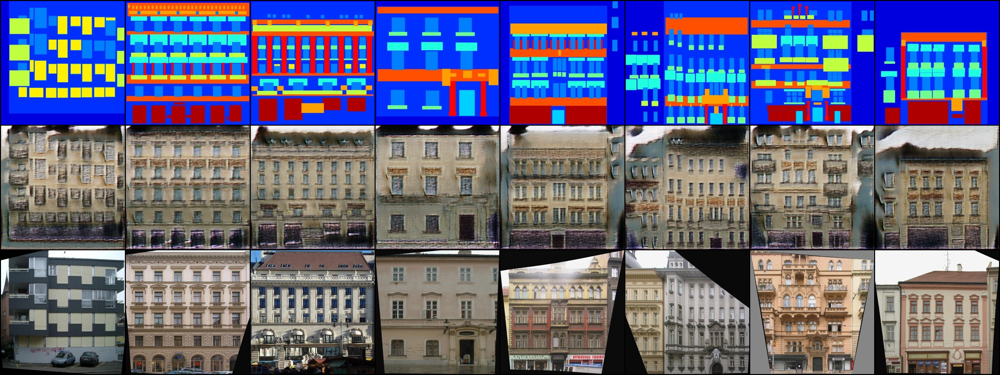

epoch: 21


epoch: 22


epoch: 23


epoch: 24


epoch: 25


epoch: 26


epoch: 27


epoch: 28


epoch: 29


epoch: 30


epoch: 31


epoch: 32


epoch: 33


epoch: 34


epoch: 35


epoch: 36


epoch: 37


epoch: 38


epoch: 39


epoch: 40
Epoch: 40


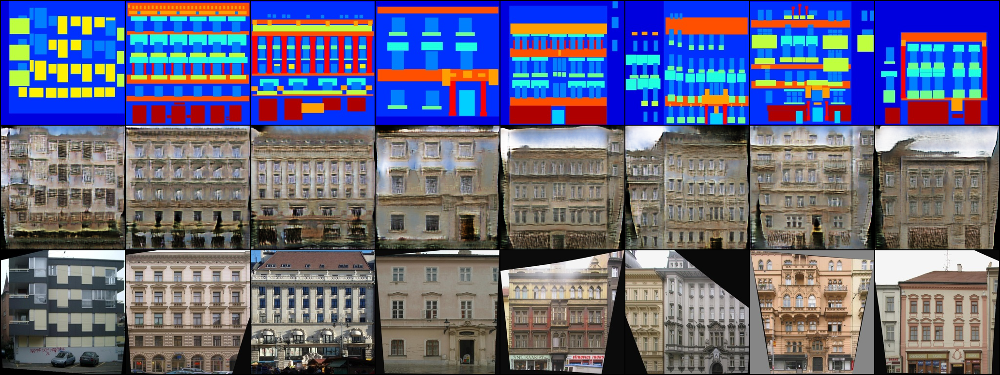

epoch: 41


epoch: 42


epoch: 43


epoch: 44


epoch: 45


epoch: 46


epoch: 47


epoch: 48


epoch: 49


epoch: 50


epoch: 51


epoch: 52


epoch: 53


epoch: 54


epoch: 55


epoch: 56


epoch: 57


epoch: 58


epoch: 59


epoch: 60
Epoch: 60


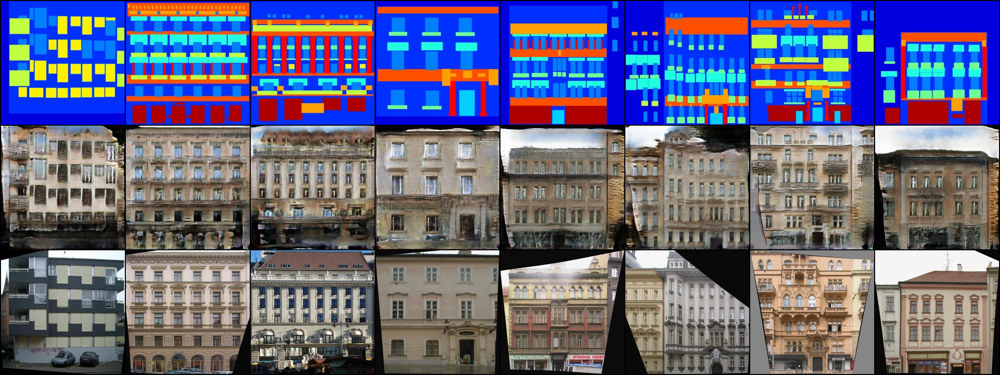

epoch: 61


epoch: 62


epoch: 63


epoch: 64


epoch: 65


epoch: 66


epoch: 67


epoch: 68


epoch: 69


epoch: 70


epoch: 71


epoch: 72


epoch: 73


epoch: 74


epoch: 75


epoch: 76


epoch: 77


epoch: 78


epoch: 79


epoch: 80
Epoch: 80


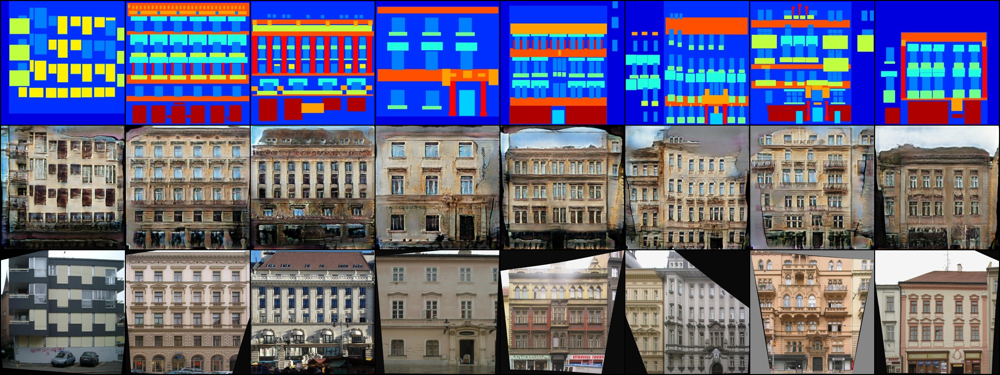

epoch: 81


epoch: 82


epoch: 83


epoch: 84


epoch: 85


epoch: 86


epoch: 87


epoch: 88


epoch: 89


epoch: 90


epoch: 91


epoch: 92


epoch: 93


epoch: 94


epoch: 95


epoch: 96


epoch: 97


epoch: 98


epoch: 99


epoch: 100
Epoch: 100


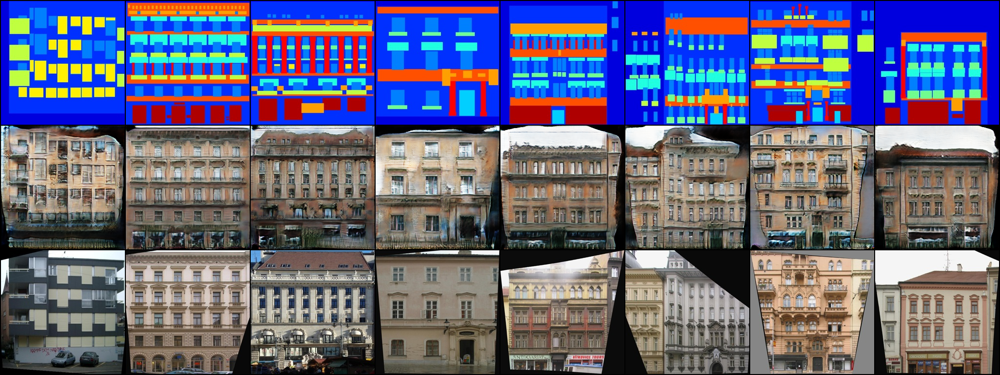

epoch: 101


epoch: 102


epoch: 103


epoch: 104


epoch: 105


epoch: 106


epoch: 107


epoch: 108


epoch: 109


epoch: 110


epoch: 111


epoch: 112


epoch: 113


epoch: 114


epoch: 115


epoch: 116


epoch: 117


epoch: 118


epoch: 119


epoch: 120
Epoch: 120


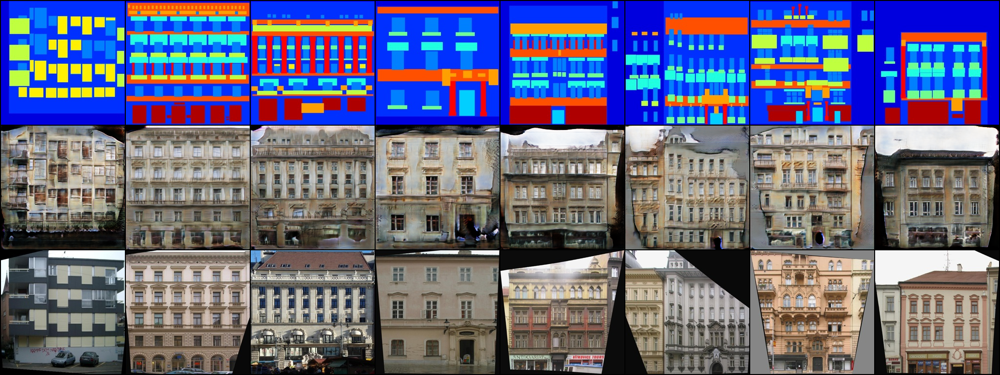

epoch: 121


epoch: 122


epoch: 123


epoch: 124


epoch: 125


epoch: 126


epoch: 127


epoch: 128


epoch: 129


epoch: 130


epoch: 131


epoch: 132


epoch: 133


epoch: 134


epoch: 135


epoch: 136


epoch: 137


epoch: 138


epoch: 139


epoch: 140
Epoch: 140


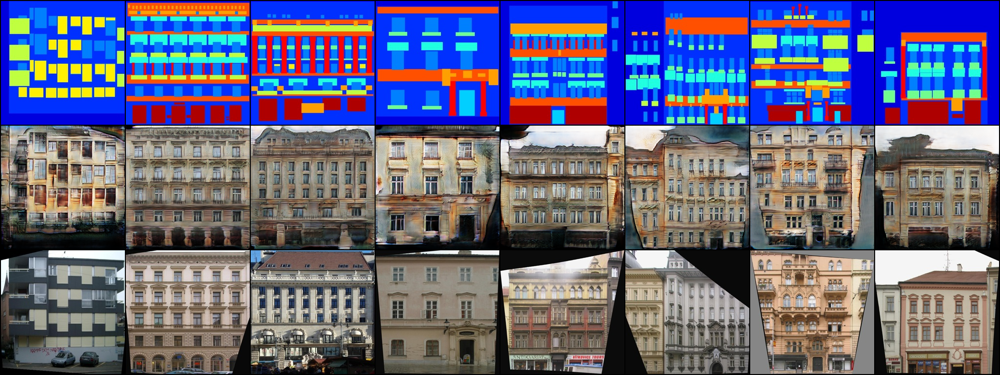

epoch: 141


epoch: 142


epoch: 143


epoch: 144


epoch: 145


epoch: 146


epoch: 147


epoch: 148


epoch: 149


epoch: 150


epoch: 151


epoch: 152


epoch: 153


epoch: 154


epoch: 155


epoch: 156


epoch: 157


epoch: 158


epoch: 159


epoch: 160
Epoch: 160


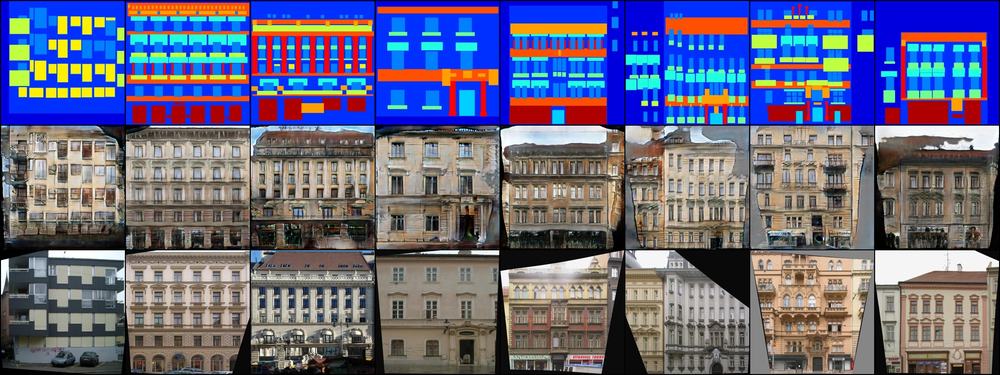

epoch: 161


epoch: 162


epoch: 163


epoch: 164


epoch: 165


epoch: 166


epoch: 167


epoch: 168


epoch: 169


epoch: 170


epoch: 171


epoch: 172


epoch: 173


epoch: 174


epoch: 175


epoch: 176


epoch: 177


epoch: 178


epoch: 179


epoch: 180
Epoch: 180


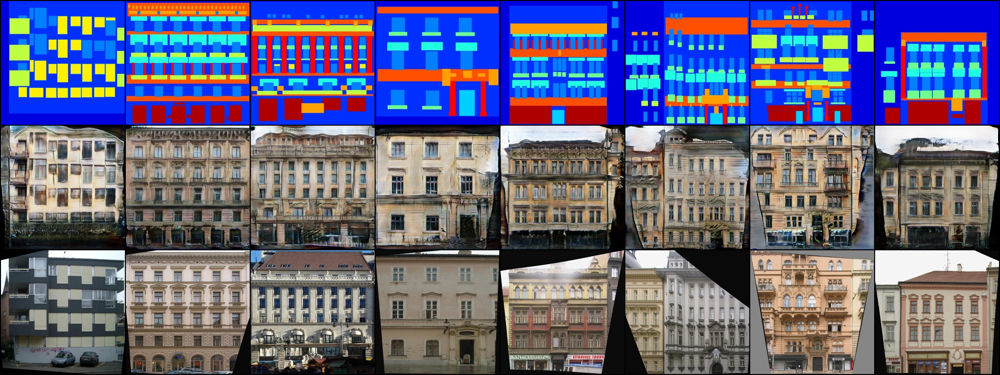

epoch: 181


epoch: 182


epoch: 183


epoch: 184


epoch: 185


epoch: 186


epoch: 187


epoch: 188


epoch: 189


epoch: 190


epoch: 191


epoch: 192


epoch: 193


epoch: 194


epoch: 195


epoch: 196


epoch: 197


epoch: 198


epoch: 199


epoch: 200
Epoch: 200


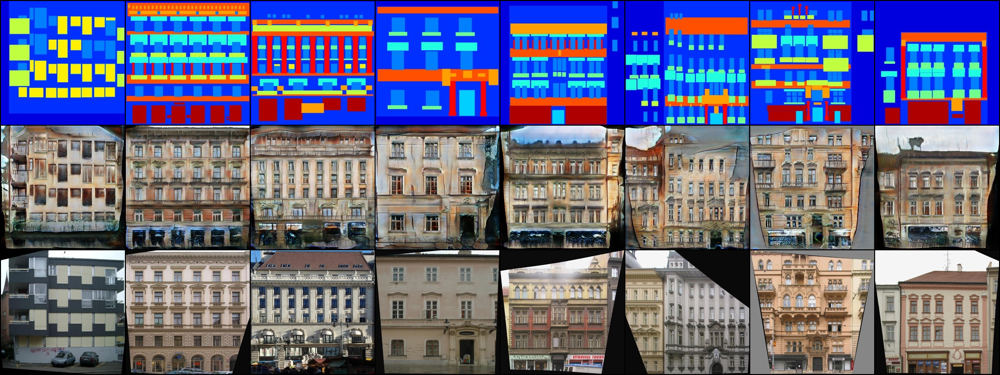

In [8]:
D_hist = []
G_hist = []
for epoch in range(1, 201):
    
    pbar = tqdm(enumerate(train_dataloader), total=len(train_dataloader), leave=False, position=0)
    for i, batch in pbar:

        condition, img_real = batch
        condition = condition.to(device)
        img_real = img_real.to(device)

        G.eval()
        D.train()
        D_optim.zero_grad()

        img_fake = G(condition)
        logits_fake = D(condition, img_fake)
        logits_real = D(condition, img_real)
        D_fake_loss = F.cross_entropy(logits_fake, torch.zeros(logits_fake.shape[0]).long().to(device))
        D_real_loss = F.cross_entropy(logits_real, torch.ones(logits_fake.shape[0]).long().to(device))
        D_loss = (D_fake_loss + D_real_loss) * 0.5
        
        D_loss.backward()
        D_optim.step()
        D_hist.append(D_loss.item())
        
        G.train()
        D.eval()
        G_optim.zero_grad()

        img_fake = G(condition)
        logits_fake = D(condition, img_fake)
        G_cross_entropy = F.cross_entropy(logits_fake, torch.ones(logits_fake.shape[0]).long().to(device))
        G_l1 = F.l1_loss(img_fake, img_real)
        G_loss = G_cross_entropy + 100 * G_l1
        
        G_loss.backward()
        G_optim.step()
        
        G_hist.append(G_loss.item())

        pbar.set_postfix({
            'D_loss': D_hist[-1],
            'G_loss': G_hist[-1],
            'G_cross_entropy': G_cross_entropy.item(),
            'G_l1': G_l1.item()
        })
    G_scheduler.step()
    D_scheduler.step()
    print(f'epoch: {epoch}')
    if epoch % 20 == 0:
        G.train() 
        print(f'Epoch: {epoch}')
        for val_condition, val_img_real in val_dataloader:
            val_condition = val_condition.to(device)
            val_img_fake = G(val_condition).cpu().detach()
            img_to_show = torch.cat([val_condition.cpu(), val_img_fake, val_img_real], dim=0)
            display(transforms.ToPILImage()(utils.make_grid(img_to_show)))
            break
    


## Часть вторая: добавим циклы

Вторая часть -- реализация CycleGAN. Предлагается на том же датасете реализовать базовую конструкцию CycleGAN для unpaired style transfer, то есть переноса стилей, каждый из которых задан неразмеченным датасетом (подробнее см. лекцию и собственно Zhu et al., 2017):


In [9]:
train_dataset = FacsdesDataset(folder='facades/train')
train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=4, shuffle=True)

val_dataset = FacsdesDataset(folder='facades/test')
val_dataloader = torch.utils.data.DataLoader(val_dataset, batch_size=8, shuffle=False)

In [10]:
Gx = UnetGenerator().to(device)
Gy = UnetGenerator().to(device)
Dx = Discriminator(is_single=True).to(device)
Dy = Discriminator(is_single=True).to(device)

In [11]:
G_optim = torch.optim.Adam(itertools.ch5ain(Gx.parameters(), Gy.parameters()), lr=0.0002, betas=(0.5, 0.999))
D_optim = torch.optim.Adam(itertools.chain(Dx.parameters(), Dy.parameters()), lr=0.0002, betas=(0.5, 0.999))

### Спаренный

Epoch: 10


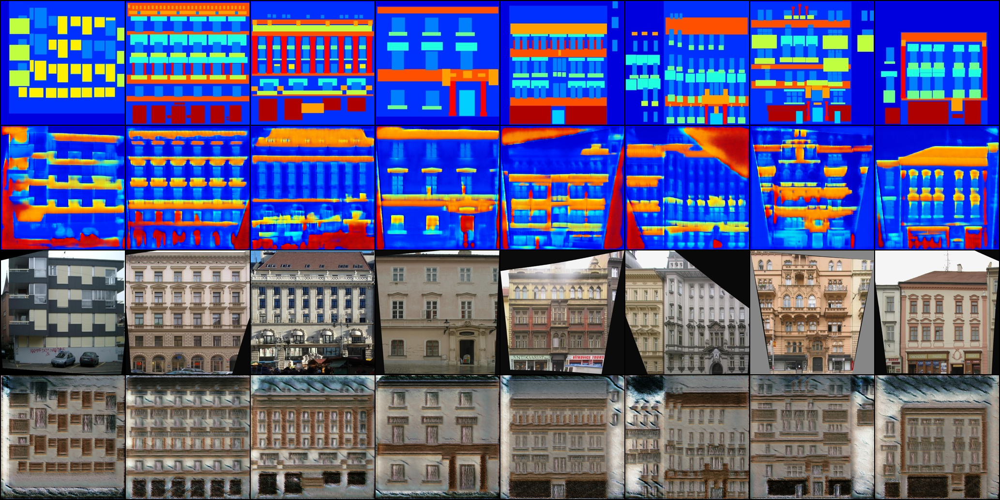

Epoch: 20


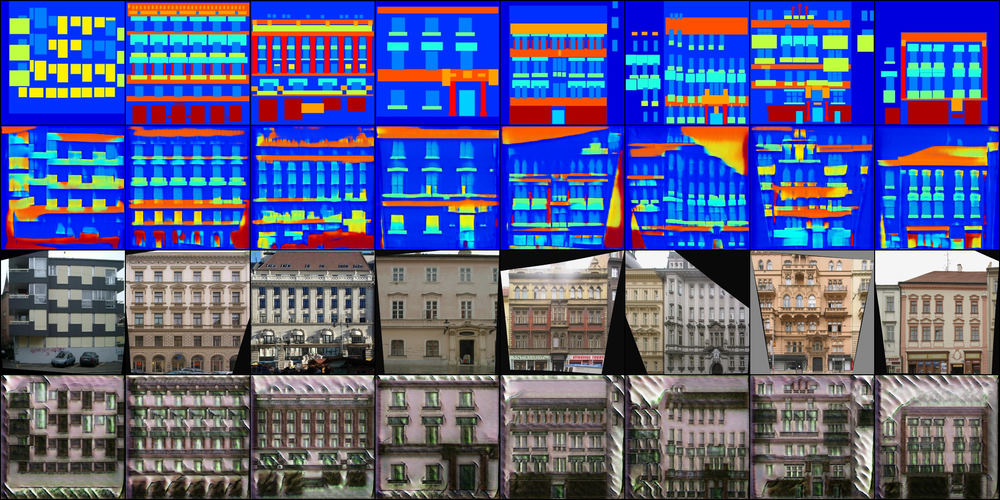

Epoch: 30


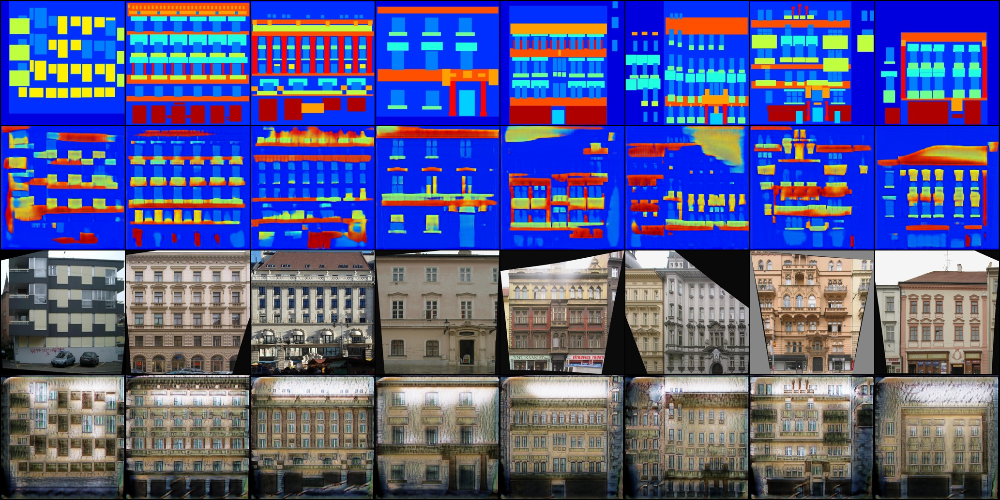

  3%|▎         | 3/100 [00:06<03:30,  2.17s/it, D_loss=0.497, G_loss=11.6, Gx_cross_entropy=2.94, Gy_cross_entropy=3.44, G_identity_rec=3.02, G_identity=2.19]

In [ ]:
for epoch in range(1, 51):
    
    pbar = tqdm(enumerate(train_dataloader), total=len(train_dataloader), leave=False, position=0)
    for i, batch in pbar:

        X, Y = batch
        X = X.to(device)
        Y = Y.to(device)

        Gx.eval()
        Gy.eval()
        Dx.train()
        Dy.train()
        D_optim.zero_grad()
 
        Y_fake = Gx(X)
        X_fake = Gy(Y)

        X_logits_fake = Dx(X_fake)
        X_logits_real = Dx(X)

        Y_logits_fake = Dy(Y_fake)
        Y_logits_real = Dy(Y)

        Dx_fake_loss = F.cross_entropy(X_logits_fake, torch.zeros(X_logits_fake.shape[0]).long().to(device))
        Dx_real_loss = F.cross_entropy(X_logits_real, torch.ones(X_logits_fake.shape[0]).long().to(device))
        Dx_loss = (Dx_fake_loss + Dx_real_loss) * 0.5

        Dy_fake_loss = F.cross_entropy(Y_logits_fake, torch.zeros(Y_logits_fake.shape[0]).long().to(device))
        Dy_real_loss = F.cross_entropy(Y_logits_real, torch.ones(Y_logits_fake.shape[0]).long().to(device))
        Dy_loss = (Dy_fake_loss + Dy_real_loss) * 0.5

        D_loss = Dx_loss + Dy_loss
        
        D_loss.backward()
        D_optim.step()
        
        
        Gx.train()
        Gy.train()
        Dx.eval()
        Dy.eval()
        G_optim.zero_grad()
        

        Y_fake = Gx(X)
        X_fake = Gy(Y)
        Y_rec = Gx(X_fake)
        X_rec = Gy(Y_fake)

        G_identity_rec = 10 * F.l1_loss(X, X_rec) + 10 * F.l1_loss(Y, Y_rec)
        G_identity = 0.5 * (10 * F.l1_loss(X, X_fake) + 10 * F.l1_loss(Y, Y_fake)) 

        X_logits_fake = Dx(X_fake)
        Y_logits_fake = Dy(Y_fake)

        Gx_cross_entropy = F.cross_entropy(X_logits_fake, torch.ones(X_logits_fake.shape[0]).long().to(device))
        Gy_cross_entropy = F.cross_entropy(Y_logits_fake, torch.ones(Y_logits_fake.shape[0]).long().to(device))
        
        G_loss = Gx_cross_entropy + Gy_cross_entropy + G_identity_rec + G_identity

        G_loss.backward()
        G_optim.step()
        

        pbar.set_postfix({
            'D_loss': D_loss.item(),
            'G_loss': G_loss.item(),
            'Gx_cross_entropy': Gx_cross_entropy.item(),
            'Gy_cross_entropy': Gy_cross_entropy.item(),
            'G_identity_rec': G_identity_rec.item(),
            'G_identity': G_identity.item(),
        })

    if epoch % 10 == 0:
        Gx.eval() 
        Gy.eval()
        print(f'Epoch: {epoch}')
        for X, Y in val_dataloader:
            X = X.to(device)
            Y = Y.to(device)
            with torch.no_grad():
                Y_fake = Gx(X).cpu().detach()
                X_fake = Gy(Y).cpu().detach()
            img_to_show = torch.cat([X.cpu(), X_fake, Y.cpu(), Y_fake], dim=0)
            display(transforms.ToPILImage()(utils.make_grid(img_to_show)))
            break

### Неспаренный

In [ ]:
class FacsdesUnpairedDataset(torch.utils.data.Dataset):
    
    def __init__(self, folder='facades/train'):
        self.folder = folder
        self.files = glob(self.folder + '/*.jpg');
        self.transforms = transforms.Compose([
            transforms.ToTensor(),
            # transforms.Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5)),
        ])
        
    def __getitem__(self, idx):
        imgs1 = Image.open(random.choice(self.files)).convert("RGB")
        imgs2 = Image.open(random.choice(self.files)).convert("RGB")
        img_from, img_to = imgs1.crop((256, 0, 512, 256)), imgs2.crop((0, 0, 256, 256))
        return self.transforms(img_from), self.transforms(img_to)    
        
    def __len__(self):
        return len(self.files)


train_unpaired_dataset = FacsdesUnpairedDataset(folder='facades/train')
train_unpaired_dataloader = torch.utils.data.DataLoader(train_unpaired_dataset, batch_size=4, shuffle=True)

val_dataset = FacsdesDataset(folder='facades/test') 
val_dataloader = torch.utils.data.DataLoader(val_dataset, batch_size=8, shuffle=False)

In [ ]:
Gx = UnetGenerator().to(device)
Gy = UnetGenerator().to(device)
Dx = Discriminator(is_single=True).to(device)
Dy = Discriminator(is_single=True).to(device)

G_optim = torch.optim.Adam(itertools.chain(Gx.parameters(), Gy.parameters()), lr=0.0002, betas=(0.5, 0.999))
D_optim = torch.optim.Adam(itertools.chain(Dx.parameters(), Dy.parameters()), lr=0.0002, betas=(0.5, 0.999))

In [ ]:
for epoch in range(1, 51):
    
    pbar = tqdm(enumerate(train_unpaired_dataloader), total=len(train_unpaired_dataloader), leave=False, position=0)
    for i, batch in pbar:

        X, Y = batch
        X = X.to(device)
        Y = Y.to(device)

        Gx.eval()
        Gy.eval()
        Dx.train()
        Dy.train()
        D_optim.zero_grad()

        Y_fake = Gx(X)
        X_fake = Gy(Y)

        X_logits_fake = Dx(X_fake)
        X_logits_real = Dx(X)

        Y_logits_fake = Dy(Y_fake)
        Y_logits_real = Dy(Y)

        Dx_fake_loss = F.cross_entropy(X_logits_fake, torch.zeros(X_logits_fake.shape[0]).long().to(device))
        Dx_real_loss = F.cross_entropy(X_logits_real, torch.ones(X_logits_fake.shape[0]).long().to(device))
        Dx_loss = (Dx_fake_loss + Dx_real_loss) * 0.5

        Dy_fake_loss = F.cross_entropy(Y_logits_fake, torch.zeros(Y_logits_fake.shape[0]).long().to(device))
        Dy_real_loss = F.cross_entropy(Y_logits_real, torch.ones(Y_logits_fake.shape[0]).long().to(device))
        Dy_loss = (Dy_fake_loss + Dy_real_loss) * 0.5

        D_loss = Dx_loss + Dy_loss
        
        D_loss.backward()
        D_optim.step()
        
        
        Gx.train()
        Gy.train()
        Dx.eval()
        Dy.eval()
        G_optim.zero_grad()
        

        Y_fake = Gx(X)
        X_fake = Gy(Y)
        Y_rec = Gx(X_fake)
        X_rec = Gy(Y_fake)

        G_identity_rec = 10 * F.l1_loss(X, X_rec) + 10 * F.l1_loss(Y, Y_rec)
        # G_identity = 0.5 * (10 * F.l1_loss(X, X_fake) + 10 * F.l1_loss(Y, Y_fake))

        X_logits_fake = Dx(X_fake)
        Y_logits_fake = Dy(Y_fake)

        Gx_cross_entropy = F.cross_entropy(X_logits_fake, torch.ones(X_logits_fake.shape[0]).long().to(device))
        Gy_cross_entropy = F.cross_entropy(Y_logits_fake, torch.ones(Y_logits_fake.shape[0]).long().to(device))

        G_loss = Gx_cross_entropy + Gy_cross_entropy + G_identity_rec # + G_identity
        
        G_loss.backward()
        G_optim.step()


        pbar.set_postfix({
            'D_loss': D_loss.item(),
            'G_loss': G_loss.item(),
            'Gx_cross_entropy': Gx_cross_entropy.item(),
            'Gy_cross_entropy': Gy_cross_entropy.item(),
            'G_identity_rec': G_identity_rec.item(),
            # 'G_identity': G_identity.item(),
        })

    if epoch % 10 == 0:
        Gx.eval() 
        Gy.eval()
        print(f'Epoch: {epoch}')
        for X, Y in val_dataloader:
            X = X.to(device)
            Y = Y.to(device)
            Y_fake = Gx(X).cpu().detach()
            X_fake = Gy(Y).cpu().detach()
            img_to_show = torch.cat([X.cpu(), X_fake, Y.cpu(), Y_fake], dim=0)
            display(transforms.ToPILImage()(utils.make_grid(img_to_show)))
            break